In [4]:
fig_save_path = '/data/peer/wallet/Jupyter/2023_Particle_SASP/figures/'

In [5]:
DATA_DIR = '/data/peer/wallet/Jupyter/2023_Particle_SASP/data/'

In [6]:
import numpy as np
import pandas as pd
import scanpy as sc
import anndata
import scipy.sparse as sparse
import matplotlib.pyplot as plt
import seaborn as sns
from kneed import KneeLocator
from scanpy.external.pp import magic
import scanpy.external as sce




In [7]:
from scrnaseq_preprocessing_utils import *

In [8]:
color_map_clusters_nogrey = ["#FFFF00", "#FF34FF", "#FF4A46", "#008941", "#006FA6", "#A30059", "#7A4900", "#0000A6", "#63FFAC", "#B79762", "#004D43", "#8FB0FF", "#997D87",
"#5A0007", "#809693", "#1B4400", "#4FC601", "#3B5DFF", "#4A3B53", "#FF2F80",
"#61615A", "#BA0900", "#6B7900", "#00C2A0", "#FFAA92", "#FF90C9", "#B903AA", "#D16100",
"#DDEFFF", "#000035", "#7B4F4B", "#A1C299", "#300018", "#0AA6D8", "#013349", "#00846F",
"#372101", "#FFB500", "#C2FFED", "#A079BF", "#CC0744", "#C0B9B2", "#C2FF99", "#001E09",
"#00489C", "#6F0062", "#0CBD66", "#EEC3FF", "#456D75", "#B77B68", "#7A87A1", "#788D66",
"#885578", "#FAD09F", "#FF8A9A", "#D157A0", "#BEC459", "#456648", "#0086ED", "#886F4C",
"#34362D", "#B4A8BD", "#00A6AA", "#452C2C", "#636375", "#A3C8C9", "#FF913F", "#938A81",
"#575329", "#00FECF", "#B05B6F", "#8CD0FF", "#3B9700", "#04F757", "#C8A1A1", "#1E6E00",
"#7900D7", "#A77500", "#6367A9", "#A05837", "#6B002C", "#772600", "#D790FF", "#9B9700",
"#549E79", "#FFF69F", "#201625", "#72418F", "#BC23FF", "#99ADC0", "#3A2465", "#922329",
"#5B4534", "#FDE8DC", "#404E55", "#0089A3", "#CB7E98", "#A4E804", "#324E72", "#6A3A4C"]
blue_red = ['#DE2A1B','#1B2ADE',"#1CE6FF", ]
#scanpy layout
sc.set_figure_params(scanpy=True, dpi=150, dpi_save=150, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=True, ipython_format='png2x')
sns.set_style('white')
sc.settings.verbosity = 3

In [9]:

batlow_20 = ['#1d2356','#1d2b59',
'#14375e',
'#134460',
'#1c5261',
'#235f5f',
'#396a58',
'#4c714e',
'#607843',
'#757e36',
'#8d8532',
'#a78b30',
'#c49138',
'#dc954d',
'#f09c6a',
'#f8a487',
'#f8aca2',
'#f8b5be',
'#f8c2d9',
'#eecbe1'] 
import random
random.seed(1)
random.shuffle(batlow_20)


# reannotate immune

In [10]:
adata_path = DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo.h5ad'
#adata_save_path = DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_immune_5000hv.h5ad'
#adata_save_path = DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_immune_2500hv.h5ad'
adata_save_path = DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_immune_7500hv.h5ad'

marker_gene_path = '/data/peer/wallet/Jupyter/2023_Particle_SASP/2023_Particle_SASP/230529_marker_genes_hv.csv'
marker_gene_sets =[ 'immune_typing_important_marker']
use_hv_genes = True
add_marker_genes=True
number_of_hv_genes = 7500


pheno_names = ['pheno_var_k10','pheno_var_k20','pheno_var_k30','pheno_var_k40','pheno_var_k50','pheno_var_k60','pheno_var_k70',
              'pheno_var_k80','pheno_var_k90','pheno_var_k100']

#pheno_names = ['pheno_k10','pheno_k20','pheno_k30','pheno_k40','pheno_k50','pheno_k60','pheno_k70',
 #             'pheno_k80','pheno_k90','pheno_k100']
pheno_ks = [10,20,30,40,50,60,70,80,90,100]

min_cells_per_gene = 10
min_gene_number = 50

In [17]:
adata = sc.read(adata_path)
adata

AnnData object with n_obs × n_vars = 207661 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF', 'apCA

In [18]:
set(adata.obs['Level 1 Annotation'])

{'Adipocyte',
 'Cancer-associated fibroblast',
 'Endocrine',
 'Endothelial',
 'Epithelial (malignant)',
 'Epithelial (non-malignant)',
 'Intra-pancreatic neurons',
 'Lymphoid',
 'Myeloid',
 'Pericyte',
 'Schwann',
 'Vascular smooth muscle'}

In [19]:
adata = adata[adata.obs['Level 1 Annotation'].isin(['Lymphoid',
 'Myeloid',])]
adata

View of AnnData object with n_obs × n_vars = 20108 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF'

In [20]:
sc.pp.filter_genes(adata, min_cells=min_cells_per_gene)

filtered out 5878 genes that are detected in less than 10 cells


/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:251: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number


In [21]:
adata

AnnData object with n_obs × n_vars = 20108 × 16286
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF', 'apCAF

In [22]:
sc.pp.filter_cells(adata, min_genes= min_gene_number)


In [14]:
adata

AnnData object with n_obs × n_vars = 20108 × 16286
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF', 'apCAF

In [15]:
if use_hv_genes:
    sc.pp.highly_variable_genes(adata,  flavor='cell_ranger', n_top_genes=number_of_hv_genes)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [16]:
number_of_hv_genes

7500

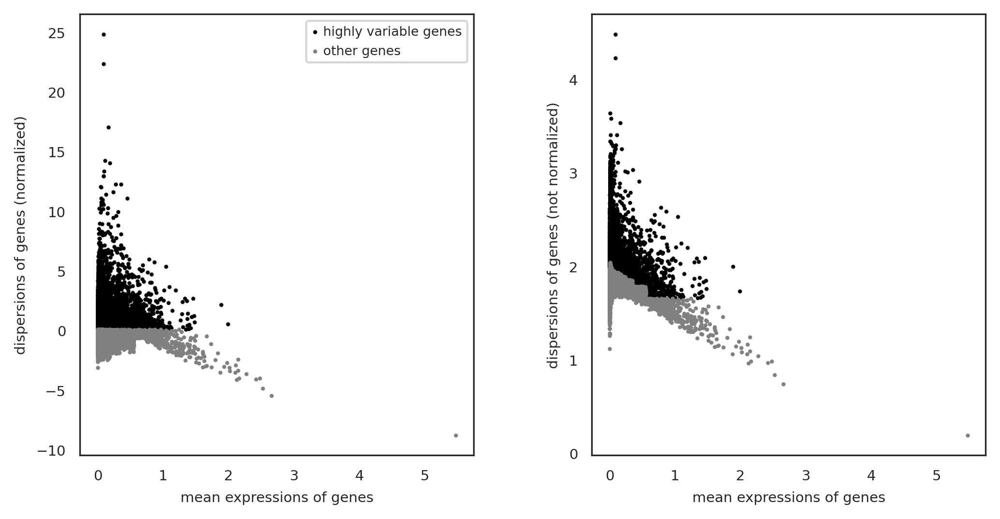

In [17]:
if use_hv_genes:
    sc.pl.highly_variable_genes(adata,  show=None, save=None, highly_variable_genes=True)

In [11]:
if add_marker_genes and use_hv_genes:
    marker_genes_df = pd.read_csv(marker_gene_path,index_col=['gene_name'])


In [12]:
#limit to human only
if add_marker_genes and use_hv_genes:
    marker_genes_df = marker_genes_df[marker_genes_df['species'] == 'homo_sapiens']
    marker_genes_df

In [13]:
#limit to markers used for distinguishing immune cells
if add_marker_genes and use_hv_genes:
    marker_genes_df = marker_genes_df[marker_gene_sets]
    marker_genes_df

In [14]:
#extract gene names
if add_marker_genes and use_hv_genes:
    marker_lists = []
    for i in marker_gene_sets:
        marker_genes_list = list(set(marker_genes_df[marker_genes_df[i]==True].index))
        marker_lists.append(marker_genes_list)
    marker_lists

In [15]:
#concatenate lists
if add_marker_genes and use_hv_genes:
    import itertools
    a = marker_lists
    marker_genes = list(itertools.chain.from_iterable(a))
    marker_genes

In [23]:
#set important marker genes as highly variable
counter = 0
if add_marker_genes and use_hv_genes:
    for i in marker_genes:
        if i in adata.var_names:
            adata.var['highly_variable'][i]= True
            counter +=1
        else: 
            print(i, 'not found')
print('added:',counter,'marker genes')

IL17F not found
KIR2DL2 not found
NCR2 not found
IFNL3 not found
C4A not found
PF4 not found
IL22 not found
ACOD1 not found
S100A15 not found
CCL15 not found
IL4 not found
FGFBP2 not found
TNFRSF13C  not found
CCL11 not found
VSIR not found
IL25 not found
GPX5 not found
CCL13 not found
IFNA17 not found
IL3 not found
IL31 not found
MASP1 not found
ELANE not found
GPX1 not found
IL12A not found
CCL27 not found
CCL14 not found
KIR3DL2 not found
PTGDR2 not found
NOS2 not found
ALK4 not found
IL20 not found
IFNA1 not found
HLA-DRB3 not found
KIR3DL3 not found
KIR2DL1 not found
IL11 not found
HLA-DRB4 not found
ZBTB46  not found
CXCL6 not found
IL17A not found
KLRK1 not found
C8A not found
CXCL11 not found
IFNA8 not found
CCL16 not found
C4B not found
CCL23 not found
IL13 not found
IL36G not found
CCL7 not found
FUT4 not found
IFNL1 not found
TACSTD2 not found
RAGE not found
CCL25 not found
CX3CL1 not found
IFNA7 not found
IL9 not found
PPBP not found
LY75 not found
CCL1 not found
KIR2DL5A n

/scratch/lsftmp/18833952.tmpdir/ipykernel_284009/1545311319.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.var['highly_variable'][i]= True


In [24]:
adata[:,'FASLG'].var['highly_variable']

FASLG    True
Name: highly_variable, dtype: bool

computing PCA
    on highly variable genes
    with n_comps=100
    finished (0:00:09)


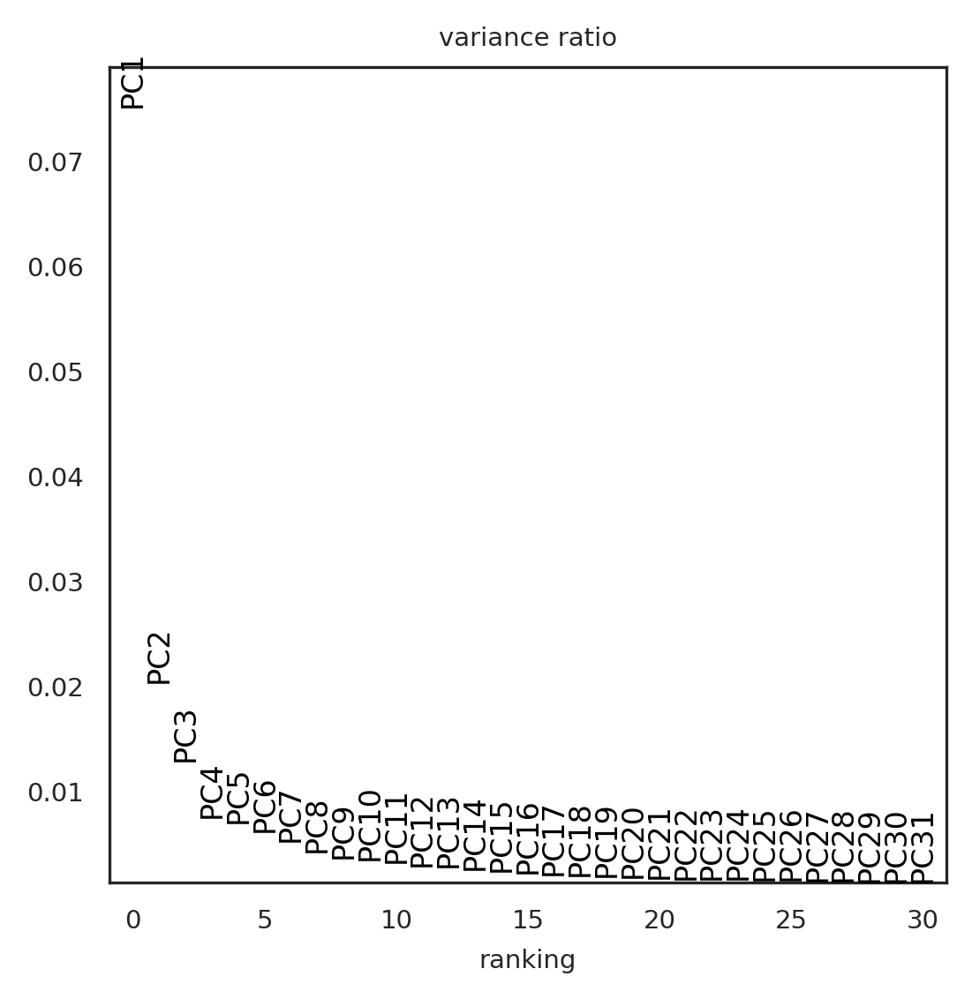

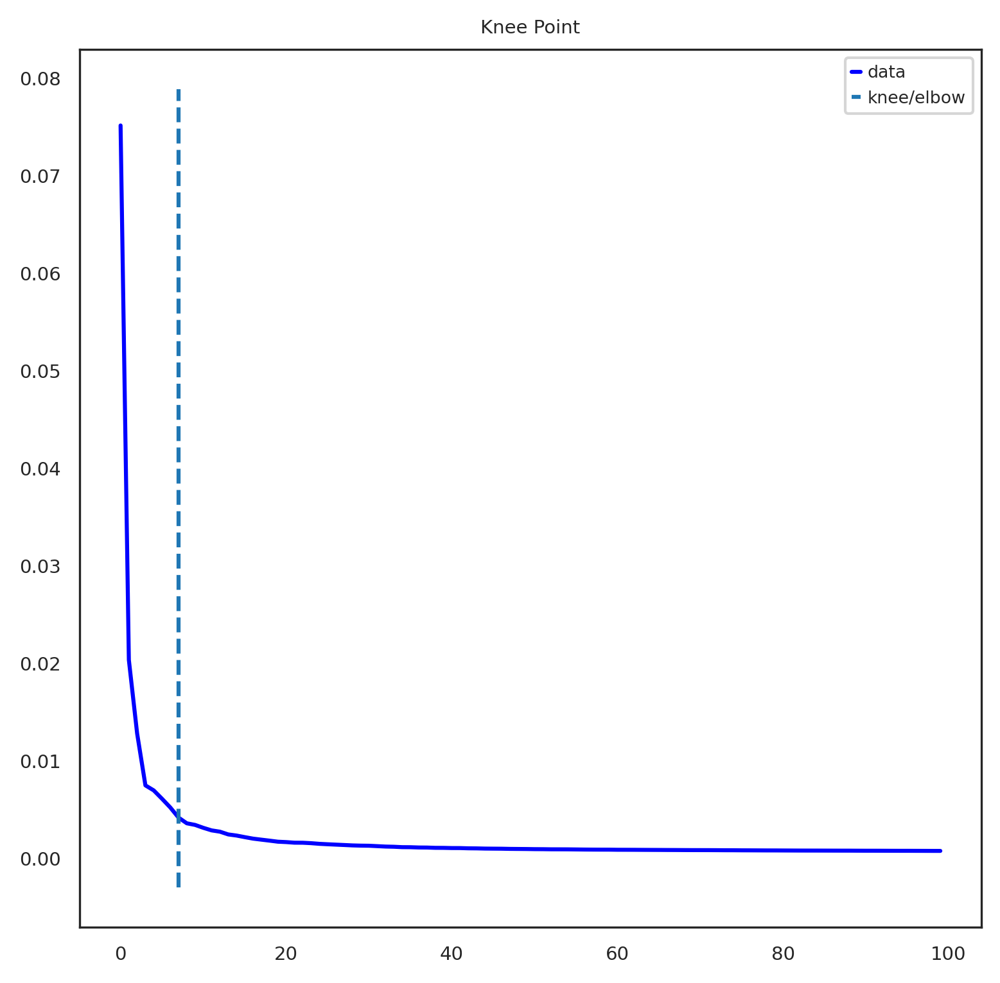

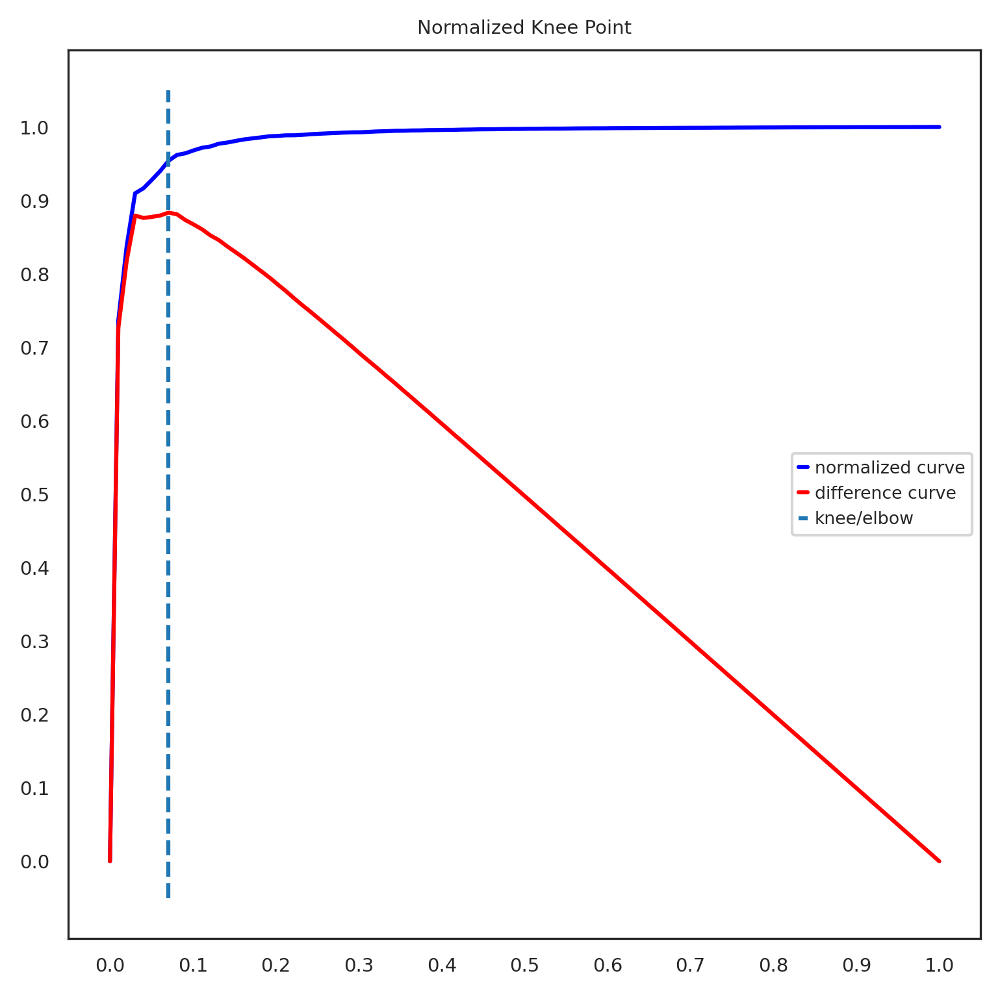

Kneepoint happens at PC: 7
7 PC explain 13.407030142843723 % of variance
2 PC explain 9.549258835613728 % of variance
3 PC explain 10.828998871147633 % of variance
4 PC explain 11.577131133526564 % of variance
5 PC explain 12.273940024897456 % of variance
6 PC explain 12.88521969690919 % of variance
7 PC explain 13.407030142843723 % of variance
8 PC explain 13.82480813190341 % of variance
9 PC explain 14.184046699665487 % of variance
10 PC explain 14.526747865602374 % of variance
11 PC explain 14.839414926245809 % of variance
12 PC explain 15.126009099185467 % of variance
13 PC explain 15.399323240853846 % of variance
14 PC explain 15.644595609046519 % of variance
15 PC explain 15.878359042108059 % of variance
16 PC explain 16.095777275040746 % of variance
17 PC explain 16.29784540273249 % of variance
18 PC explain 16.489402868319303 % of variance
19 PC explain 16.670809034258127 % of variance
20 PC explain 16.841444931924343 % of variance
21 PC explain 17.008066771086305 % of variance

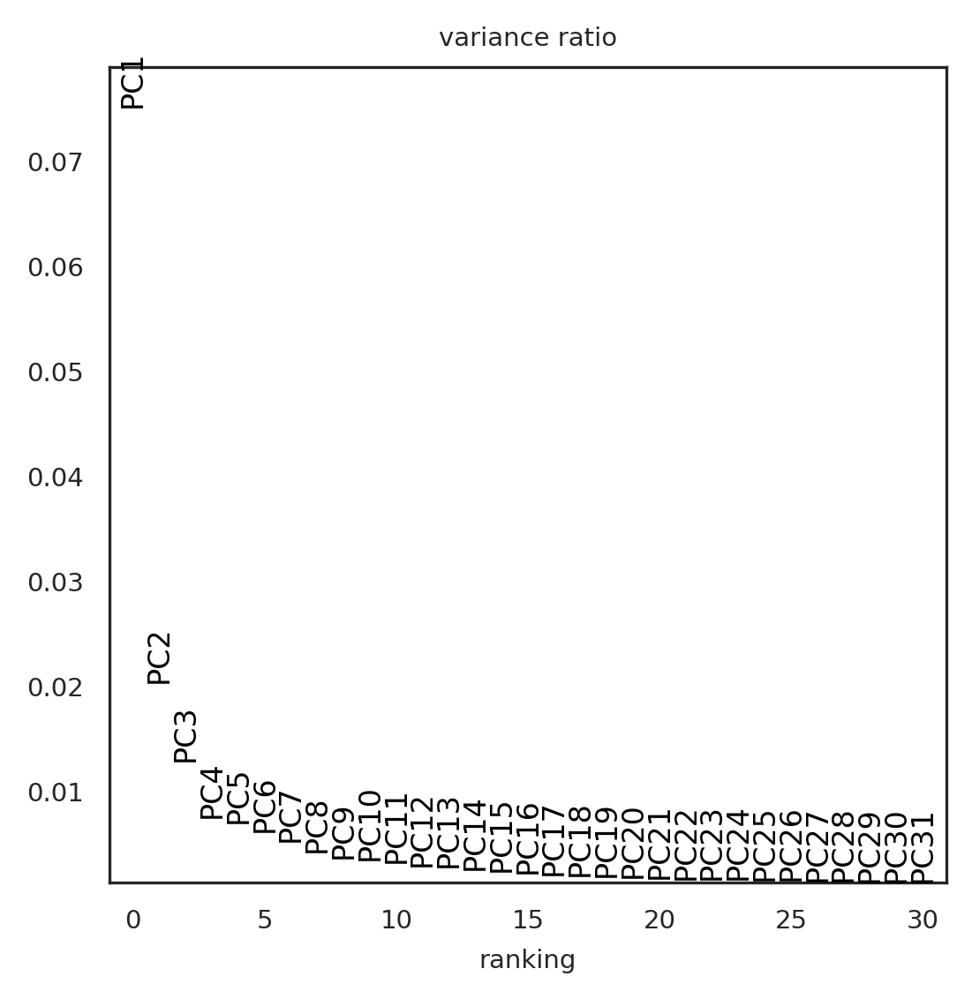

In [25]:
if use_hv_genes:
    number_of_PC_used = calculate_optimal_PC(adata, min_PC = 50, min_var=25, n_comps=100, use_hv=True)
else:
    number_of_PC_used = calculate_optimal_PC(adata, min_PC = 50, min_var=25, n_comps=100, use_hv=False)

In [26]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=number_of_PC_used)
sc.tl.umap(adata)

computing neighbors
    using 'X_pca' with n_pcs = 100
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:22)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:17)


In [27]:
for i,v in enumerate(pheno_names):
    result_pheno_ndf_all = sce.tl.phenograph(adata.obsm['X_pca'], k = pheno_ks[i], seed=1)
    adata.obs[v] = pd.Categorical(result_pheno_ndf_all[0])

PhenoGraph clustering
Finding 10 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 9.026564359664917 seconds
Jaccard graph constructed in 4.79132604598999 seconds
Wrote graph to binary file in 0.06157493591308594 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.92816
Louvain completed 21 runs in 3.1788859367370605 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 21.123311042785645 seconds
    finished (0:00:21)
PhenoGraph clustering
Finding 20 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 7.945843696594238 seconds
Jaccard graph constructed in 6.23424768447876 seconds
Wrote graph to binary file in 0.14924168586730957 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.909728
Louvain completed 21 runs in 4.6162755489349365 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 23.5976161956

In [28]:
#impute data
adata_indf = magic(adata, copy=True, verbose=True, solver='exact', n_pca=adata.obsm['X_pca'].shape[1], knn=5, t=3)
adata.layers['imputed'] = adata_indf.X

computing MAGIC
Calculating MAGIC...
  Running MAGIC on 20108 cells and 16286 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 10.65 seconds.
    Calculating KNN search...
    Calculated KNN search in 34.06 seconds.
    Calculating affinities...
    Calculated affinities in 34.14 seconds.
  Calculated graph and diffusion operator in 78.87 seconds.
  Running MAGIC with `solver='exact'` on 16286-dimensional data may take a long time. Consider denoising specific genes with `genes=<list-like>` or using `solver='approximate'`.
  Calculating imputation...
  Calculated imputation in 14.22 seconds.
Calculated MAGIC in 93.32 seconds.
    finished (0:01:33)


In [29]:
adata.write(adata_save_path)
print('saved data to:',adata_save_path)

saved data to: /data/peer/wallet/Jupyter/2023_Particle_SASP/data/TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_immune_7500hv.h5ad


# plot cells

In [7]:
#adata paths
pheno_names = ['pheno_var_k10','pheno_var_k20','pheno_var_k30','pheno_var_k40','pheno_var_k50','pheno_var_k60','pheno_var_k70',
             'pheno_var_k80','pheno_var_k90','pheno_var_k100']
pheno_heat = 'pheno_var_k20'  
adata_path =  DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_immune_2500hv.h5ad'
#pheno_names = ['pheno_k10','pheno_k20','pheno_k30','pheno_k40','pheno_k50','pheno_k60','pheno_k70',
#               'pheno_k80','pheno_k90','pheno_k100']
#adata_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito_clustered_nodrops_doublets_nodoubs_libsize_log1p_clustered_10000hv_genes_curated_marker_genes_210216_leukocytes_scran_annotated_clustered_imputed.h5ad'
#set parameters
imputed = True
continue_with_adata = False #load new adata indicated by paths below or continue with loaded adata object
TILC_genes = ['CD3D','CD3E','CD4','CD8A','TRAC','TRBC1','TRDC','FOXP3','IL2RA','NCAM1','NCR1','KLRB1C','CXCR1','CXCR2','FGFBP2','PRF1','IFNG','ICOS','KIT','THY1','GZMB','FCGR3A','FCGR3B']
B_genes = ['MS4A1','CD19','CD27','SDC1','AICDA','IGHD','IGHM','IGHG1','IGHG2B','IGHG2C','IGHA']
M_genes = ['CD68','MRC1','CD14','FUT4','CSF3R','CXCR1','HDC','ID2','BATF3','IRF8','TCF4','IRF4','CD207']
marker_genes = [TILC_genes, B_genes, M_genes]
marker_genes_filtered = [[],[],[]]

In [8]:
import cytopus as cp
G = cp.kb.KnowledgeBase()

KnowledgeBase object containing 75 cell types and 201 cellular processes



In [9]:
#load AnnData object
if continue_with_adata == False:
    adata = sc.read(adata_path)

In [10]:
adata

AnnData object with n_obs × n_vars = 20108 × 16286
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF', 'apCAF

In [30]:
# Filter out genes not present in single cell data
for i,v in enumerate(marker_genes):
    for marker in v:
        if marker in adata.var.index:   
            marker_genes_filtered[i].append(marker)
            marker_genes_filtered[i] = list(set(marker_genes_filtered[i]))
        else:
            print(marker + ' filtered out')
            

KLRB1C filtered out
FGFBP2 filtered out
IGHG2B filtered out
IGHG2C filtered out
IGHA filtered out
FUT4 filtered out


In [31]:
#imputed variable serves to define option in sc.pl.umap function

if imputed == True:
    select_layer = 'imputed'
else:
    select_layer = None

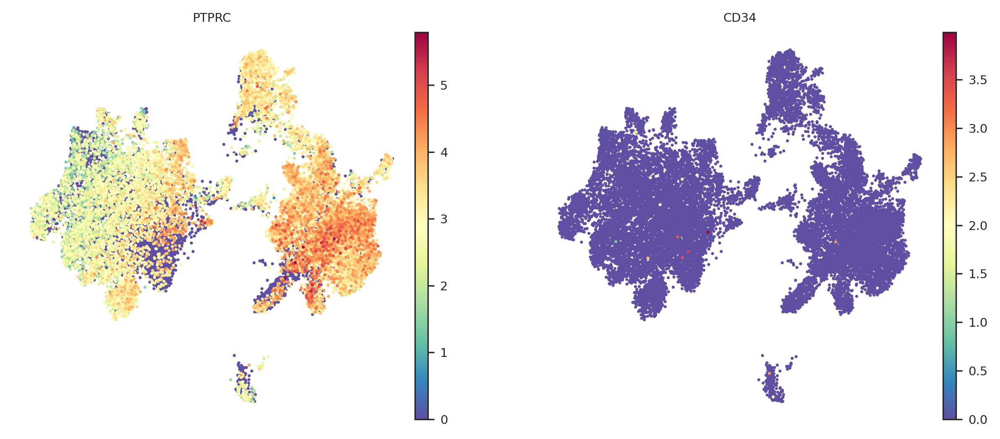

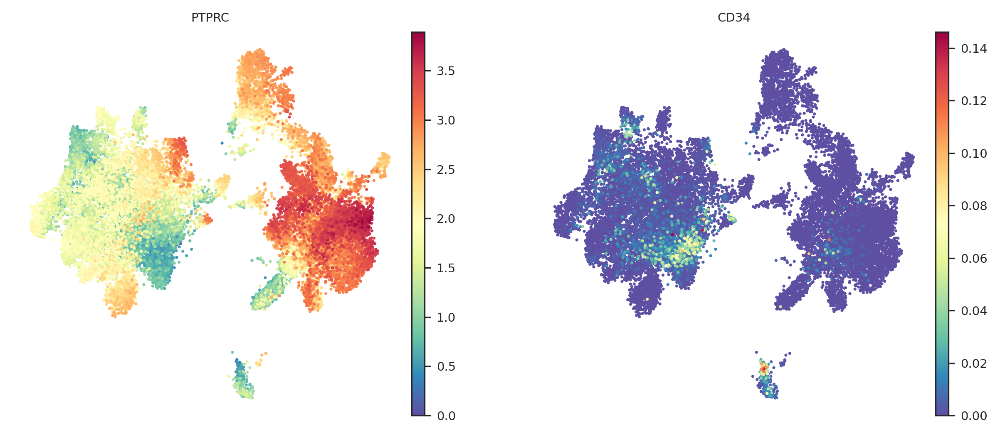

In [32]:
#stem cells, erythrocyte contamination
genes_oi = ['PTPRC','HBB','HBA1','HBA2','CD34']
genes_oi = [x for x in genes_oi if x in adata.var_names]
sc.pl.umap(adata, color = genes_oi, s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = genes_oi, layer='imputed', s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)

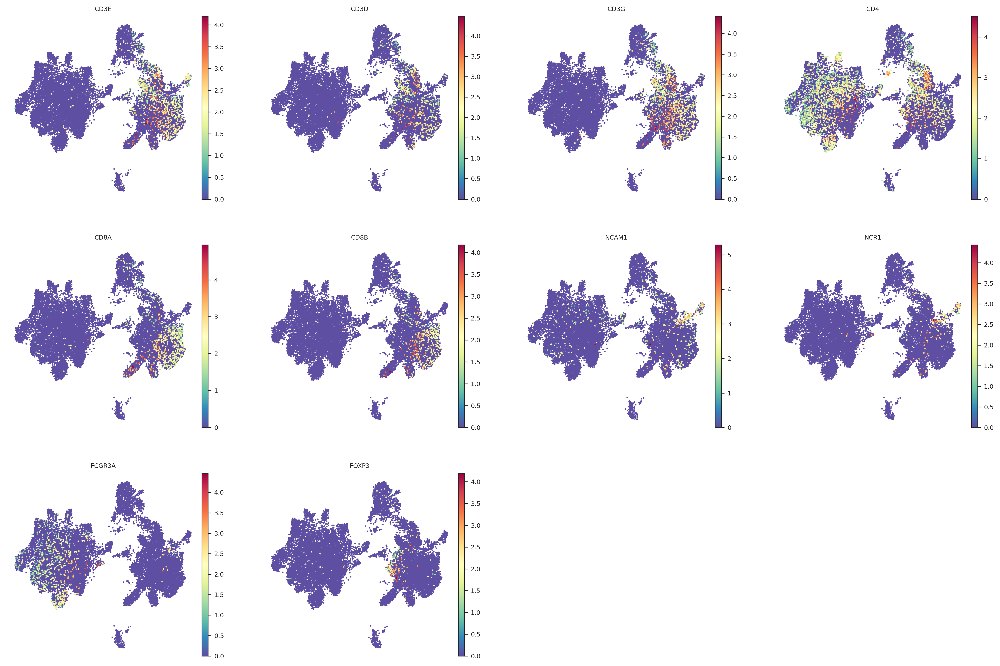

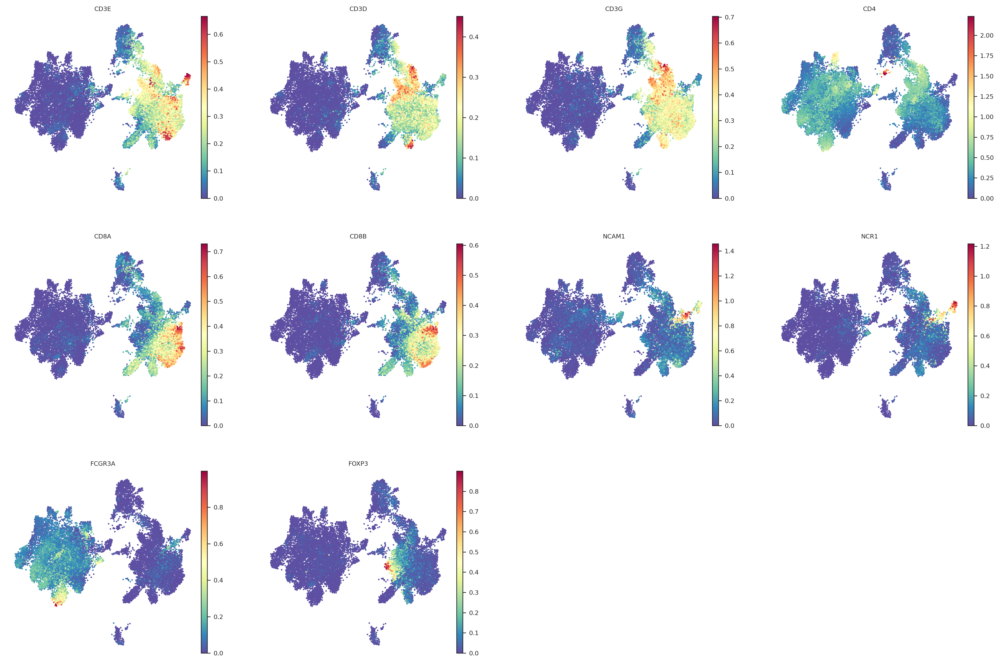

In [33]:
#markers
genes_oi = ['CD3E','CD3D','CD3G','CD4','CD8A','CD8B','NCAM1','NCR1','FCGR3A','FOXP3']
genes_oi = [x for x in genes_oi if x in adata.var_names]
sc.pl.umap(adata, color = genes_oi, s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = genes_oi, layer='imputed', s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)

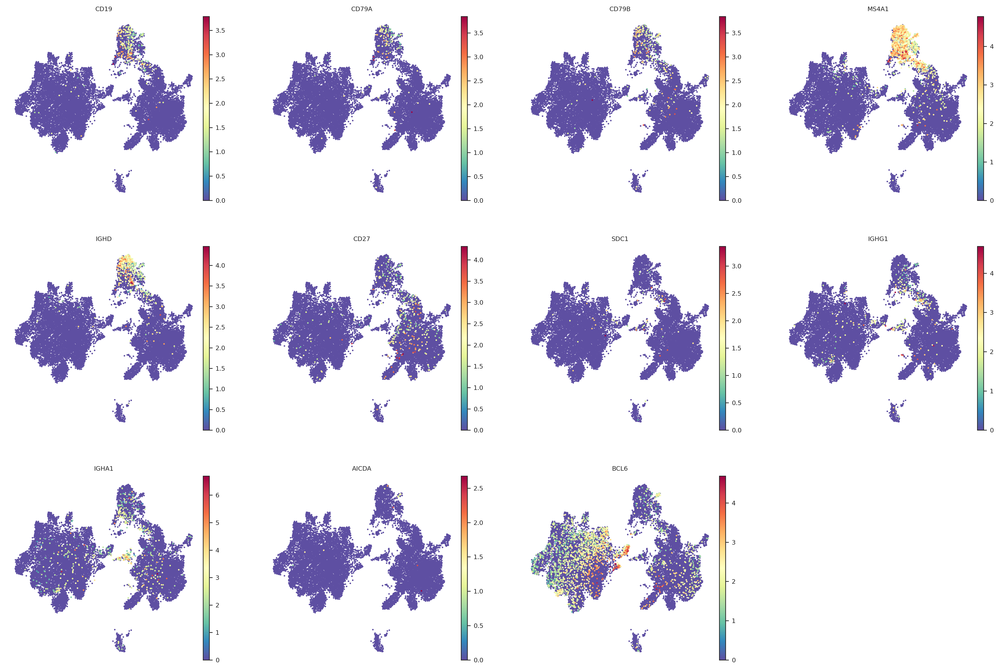

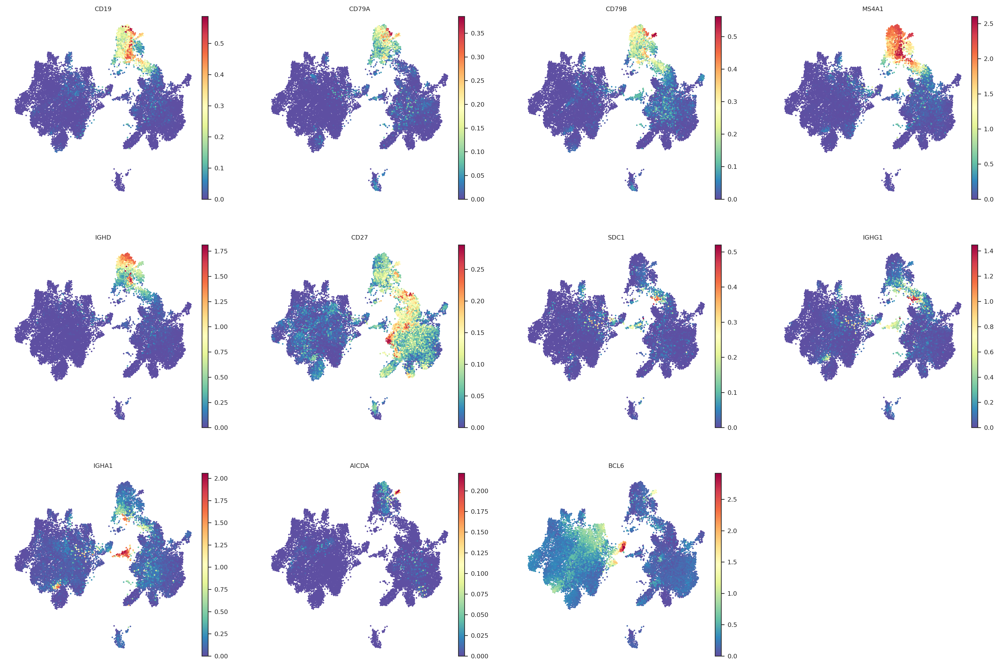

In [34]:
#markers
genes_oi = ['CD19','CD79A','CD79B','MS4A1','IGHD','CD27','SDC1','IGHG1','IGHA1','AICDA','BCL6']
genes_oi = [x for x in genes_oi if x in adata.var_names]
sc.pl.umap(adata, color = genes_oi, s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = genes_oi, layer='imputed', s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)

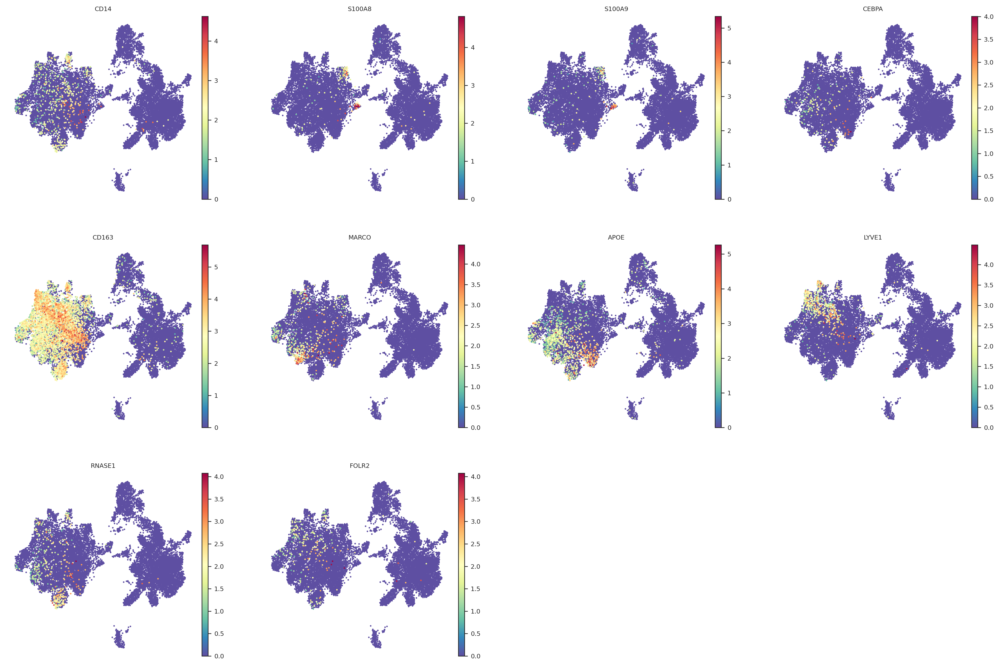

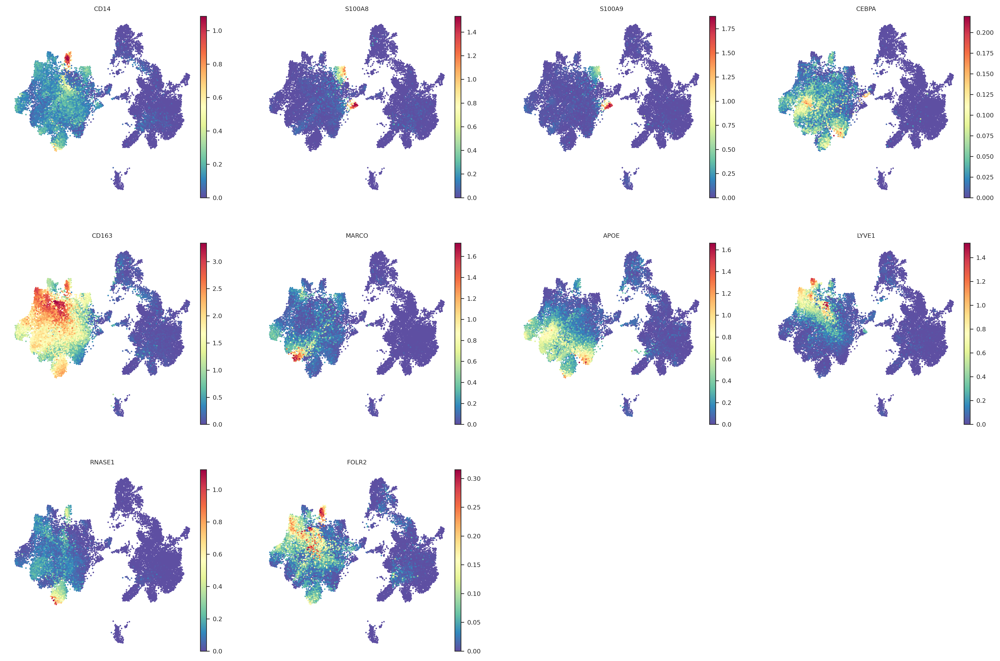

In [35]:
#markers
genes_oi = ['CD14','S100A8','S100A9','CEBPA','CD163','MARCO','APOE','LYVE1','RNASE1','FOLR2']
genes_oi = [x for x in genes_oi if x in adata.var_names]
sc.pl.umap(adata, color = genes_oi, s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = genes_oi, layer='imputed', s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)

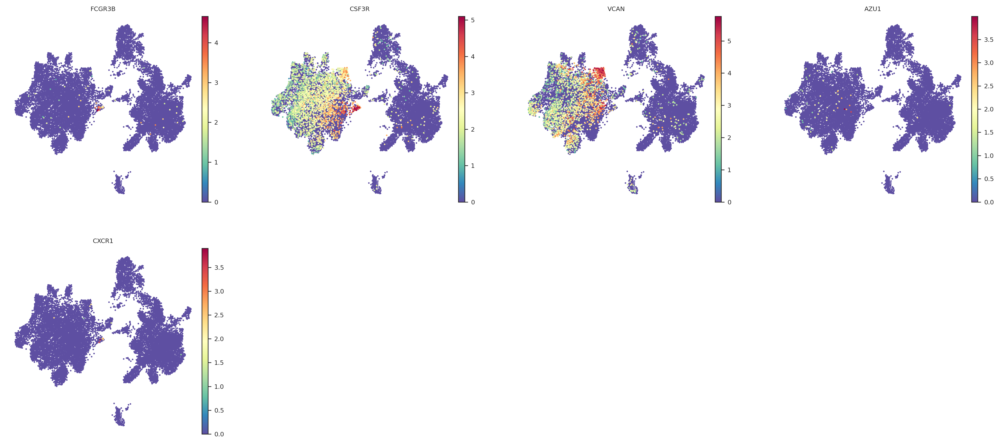

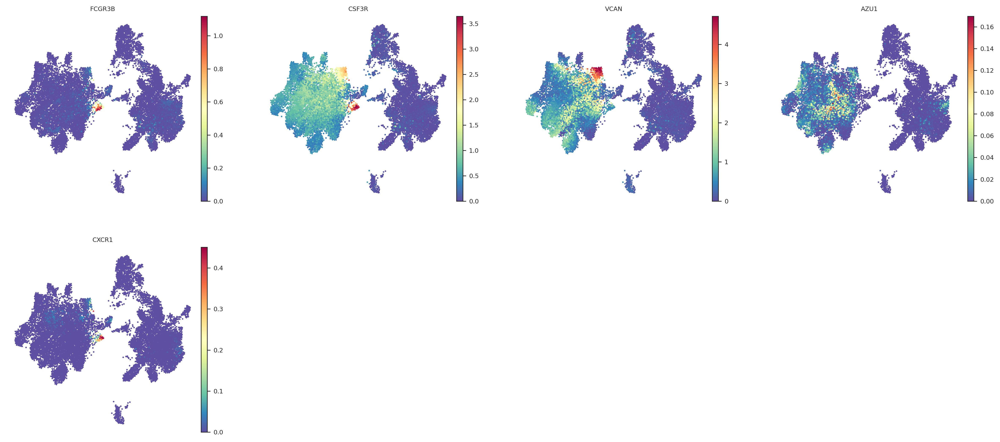

In [36]:
#markers
genes_oi = ['FCGR3B','CSF3R','VCAN','AZU1','CXCR1']
genes_oi = [x for x in genes_oi if x in adata.var_names]
sc.pl.umap(adata, color = genes_oi, s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = genes_oi, layer='imputed', s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)

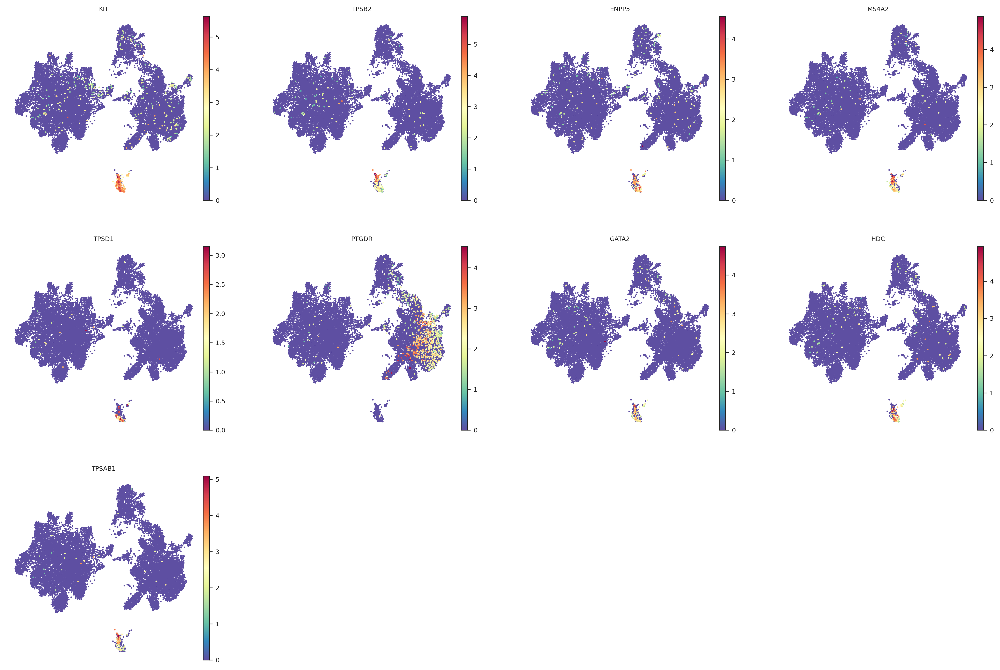

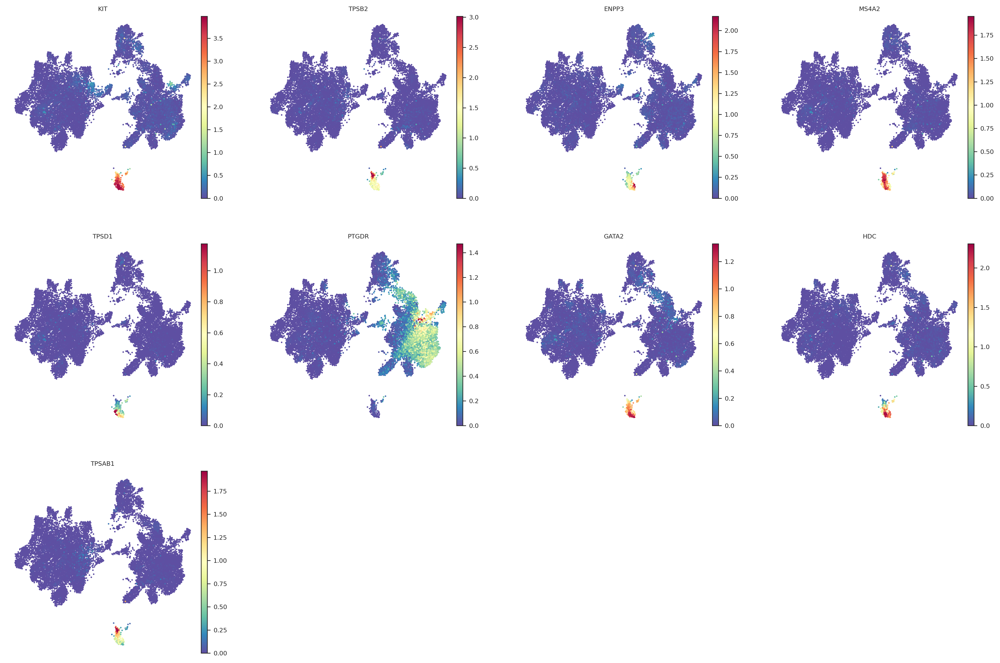

In [37]:
#markers
genes_oi = G.identities['mast']
genes_oi = [x for x in genes_oi if x in adata.var_names]
sc.pl.umap(adata, color = genes_oi, s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = genes_oi, layer='imputed', s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)

In [38]:
G.identities.keys()

dict_keys(['TCM', 'TSCM', 'CD8-T_KLRG1pos-effector', 'TEM', 'FDC', 'Langerhans', 'B-memory-DN', 'Treg', 'B-memory-non-switched', 'CD56bright-NK', 'mono', 'B-pb-t1', 'NK-adaptive', 'mast', 'TRM', 'CD4-T', 'cDC2', 'p-DC', 'GC-B', 'B-memory-IgM-MZ', 'CD8-T', 'NK', 'T', 'ILC2', 'mo-DC', 'capillary', 'endo-systemic-venous', 'cDC3', 'B', 'gran', 'CD56dim-NK', 'cDC1', 'B-pb-t2', 'Lti', 'plasma', 'B-pb-mature', 'gdT', 'plasma-blast', 'CD8-T-progenitor-exhausted', 'Mac', 'B-memory-switched', 'ILC1', 'ILC3-NCRpos', 'CD8-T_KLRG1neg-effector', 'lung-endo-venous', 'ILC3-NCRneg', 'B-memory', 'endo-aerocyte', 'T-naive', 'B-naive'])

# calculate pairwise rand index

In [40]:
#set parameters
continue_with_adata = False #load new adata indicated by paths below or continue with loaded adata object

#adata paths

pheno_names = ['pheno_var_k10','pheno_var_k20','pheno_var_k30','pheno_var_k40','pheno_var_k50','pheno_var_k60','pheno_var_k70',
              'pheno_var_k80','pheno_var_k90','pheno_var_k100']
#pheno_names = ['pheno_k10','pheno_k20','pheno_k30','pheno_k40','pheno_k50','pheno_k60','pheno_k70',
#             'pheno_k80','pheno_k90','pheno_k100']

In [41]:
from sklearn.metrics import adjusted_rand_score

In [42]:
if continue_with_adata == False:
    adata_sample = sc.read(adata_path)
adata_sample   

AnnData object with n_obs × n_vars = 20108 × 16286
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF', 'apCAF

In [43]:
#bootstrap 10000 cells from adata to avoid int overflow,if adata < 100 000 cells use all cells

if len(adata.obs_names) > 100000:
    adata_sample = adata[adata.obs.sample(n=100000, replace=False, random_state=1, axis=0).index,:]

In [44]:
#if you get overflow error that means that the calculation intermediate results are too big to store into np.int64
#this messes up the entire calculatation so you have to downsample the cells
rand_indices = pd.DataFrame(index=pheno_names, columns=pheno_names)

for i in pheno_names:
    for j in pheno_names:
        a = np.int64(np.array(adata_sample.obs[i]))
        b = np.int64(np.array(adata_sample.obs[j]))
        c = adjusted_rand_score(a, b)
        rand_indices.loc[i,j] = c

In [45]:
rand_indices

,pheno_var_k10,pheno_var_k20,pheno_var_k30,pheno_var_k40,pheno_var_k50,pheno_var_k60,pheno_var_k70,pheno_var_k80,pheno_var_k90,pheno_var_k100
pheno_var_k10,1.0,0.673403,0.646004,0.61389,0.636148,0.595576,0.623283,0.595005,0.576654,0.566608
pheno_var_k20,0.673403,1.0,0.848362,0.830011,0.841258,0.795588,0.81977,0.781975,0.755761,0.743386
pheno_var_k30,0.646004,0.848362,1.0,0.861938,0.865402,0.81852,0.812991,0.785016,0.749927,0.739004
pheno_var_k40,0.61389,0.830011,0.861938,1.0,0.902553,0.908613,0.858887,0.871985,0.82897,0.80812
pheno_var_k50,0.636148,0.841258,0.865402,0.902553,1.0,0.880412,0.897873,0.842753,0.814828,0.799845
pheno_var_k60,0.595576,0.795588,0.81852,0.908613,0.880412,1.0,0.87555,0.915119,0.86582,0.852056
pheno_var_k70,0.623283,0.81977,0.812991,0.858887,0.897873,0.87555,1.0,0.899114,0.866254,0.840045
pheno_var_k80,0.595005,0.781975,0.785016,0.871985,0.842753,0.915119,0.899114,1.0,0.914569,0.890149
pheno_var_k90,0.576654,0.755761,0.749927,0.82897,0.814828,0.86582,0.866254,0.914569,1.0,0.881502
pheno_var_k100,0.566608,0.743386,0.739004,0.80812,0.799845,0.852056,0.840045,0.890149,0.881502,1.0


<AxesSubplot:>

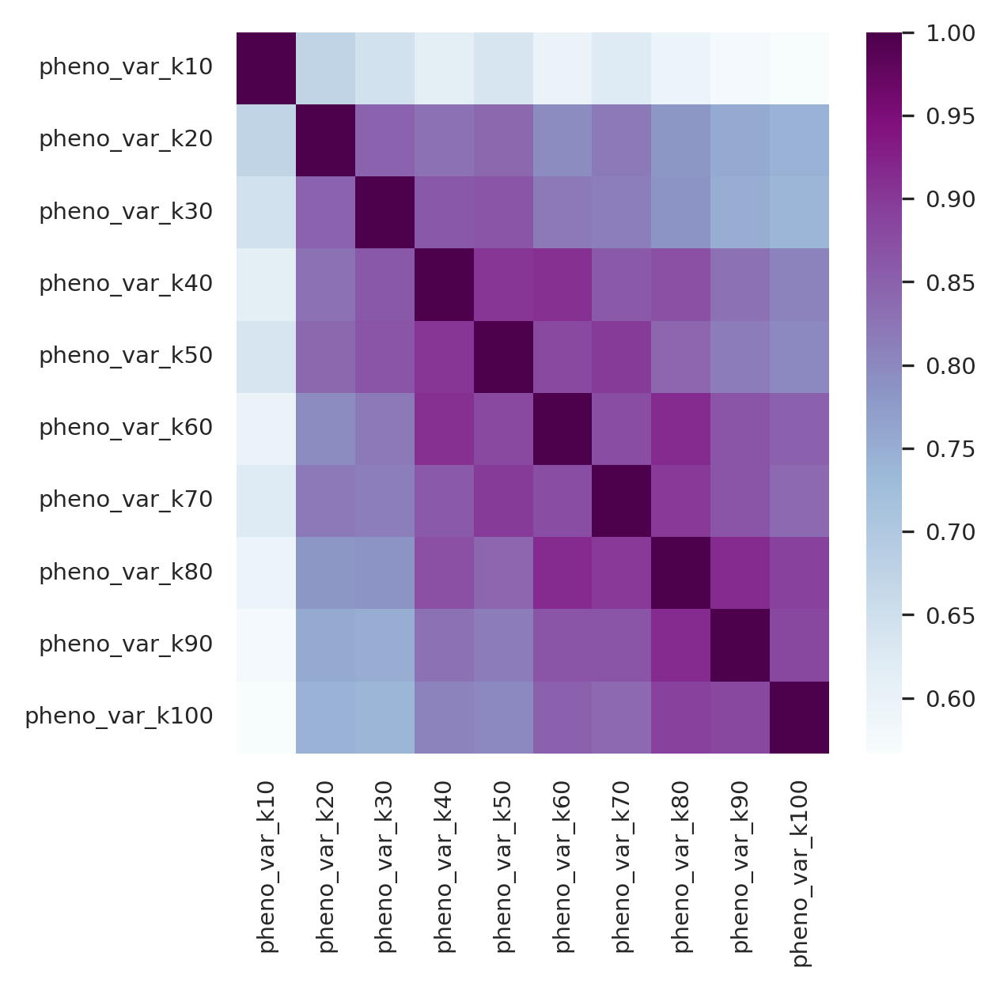

In [46]:
#plot rand indices
sns.heatmap(rand_indices.astype('float'),
                    cmap='BuPu',
                    cbar=True,
                    yticklabels=True,
                    xticklabels=True,
                  # vmax=1,
                   # center=0.5,
                    #vmin=0)
            )

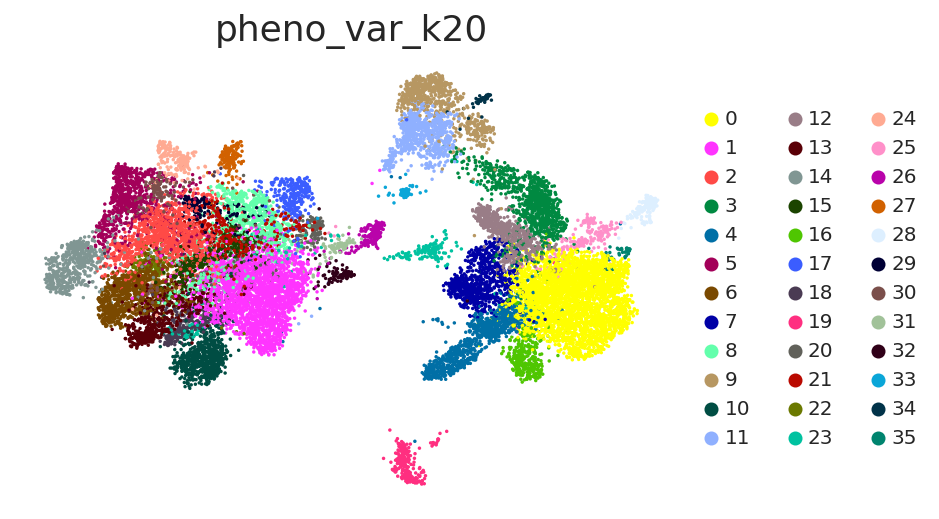

In [71]:
sc.pl.umap(adata, color = pheno_heat, palette=color_map_clusters_nogrey, s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)

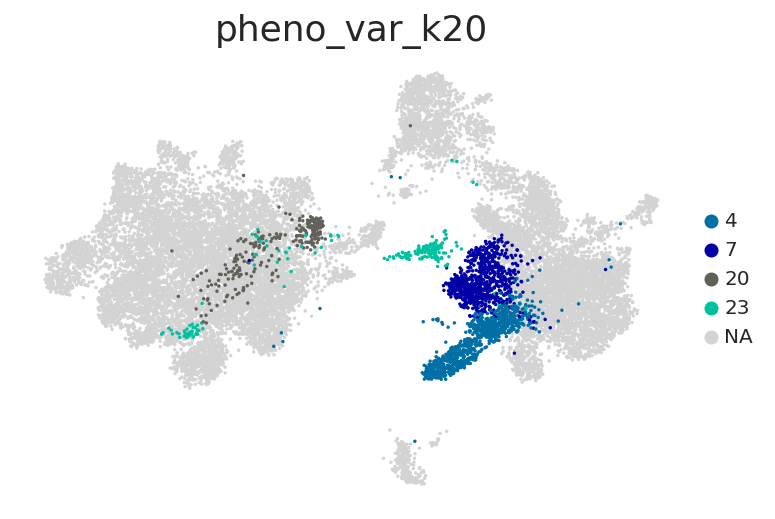

In [72]:
sc.pl.umap(adata, color = pheno_heat, groups=[4,7,20,23],palette=color_map_clusters_nogrey, s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)

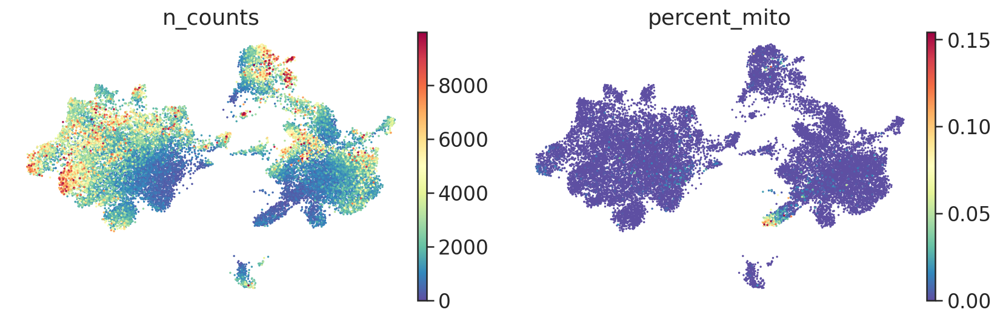

In [76]:
sc.pl.umap(adata, color = ['n_counts','percent_mito'],palette=color_map_clusters_nogrey, s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)



In [49]:
G.identities.keys()

dict_keys(['TCM', 'TSCM', 'CD8-T_KLRG1pos-effector', 'TEM', 'FDC', 'Langerhans', 'B-memory-DN', 'Treg', 'B-memory-non-switched', 'CD56bright-NK', 'mono', 'B-pb-t1', 'NK-adaptive', 'mast', 'TRM', 'CD4-T', 'cDC2', 'p-DC', 'GC-B', 'B-memory-IgM-MZ', 'CD8-T', 'NK', 'T', 'ILC2', 'mo-DC', 'capillary', 'endo-systemic-venous', 'cDC3', 'B', 'gran', 'CD56dim-NK', 'cDC1', 'B-pb-t2', 'Lti', 'plasma', 'B-pb-mature', 'gdT', 'plasma-blast', 'CD8-T-progenitor-exhausted', 'Mac', 'B-memory-switched', 'ILC1', 'ILC3-NCRpos', 'CD8-T_KLRG1neg-effector', 'lung-endo-venous', 'ILC3-NCRneg', 'B-memory', 'endo-aerocyte', 'T-naive', 'B-naive'])

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_pheno_var_k20']`


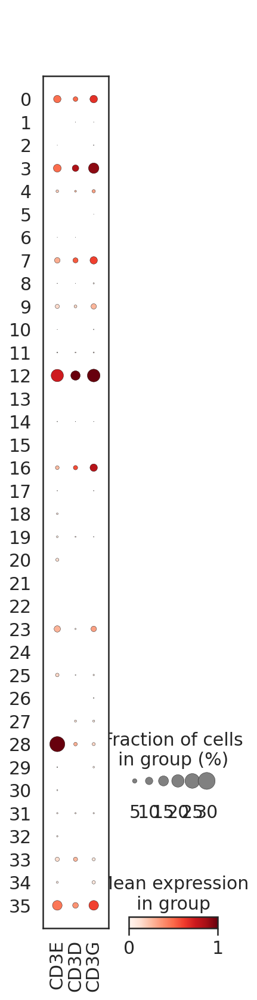

In [52]:
#dotplot
%matplotlib inline
marker_genes_filtered = G.identities['T']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_pheno_var_k20']`


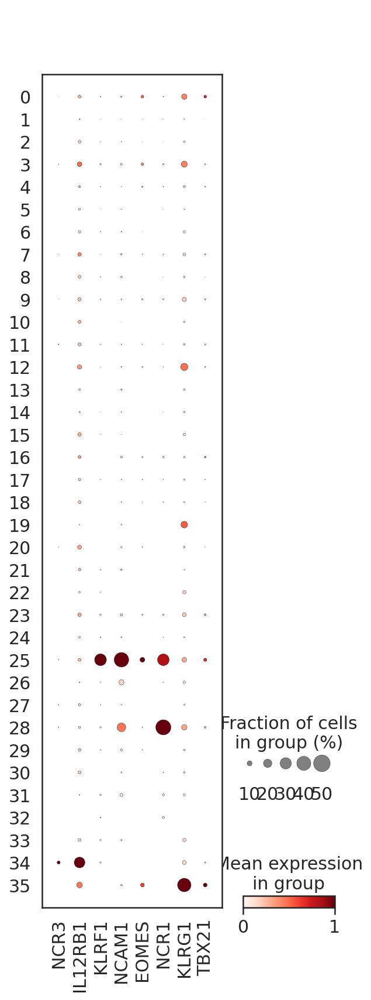

In [58]:
#dotplot
%matplotlib inline
marker_genes_filtered = G.identities['NK']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_pheno_var_k20']`


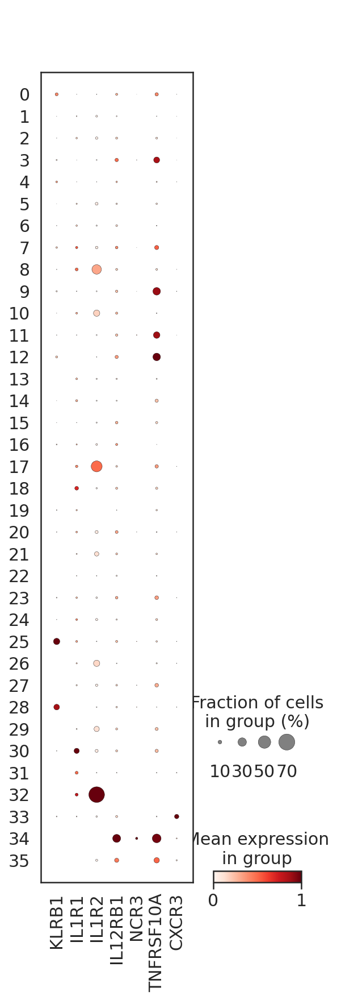

In [67]:
#dotplot
%matplotlib inline
marker_genes_filtered = G.identities['ILC1']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_pheno_var_k20']`


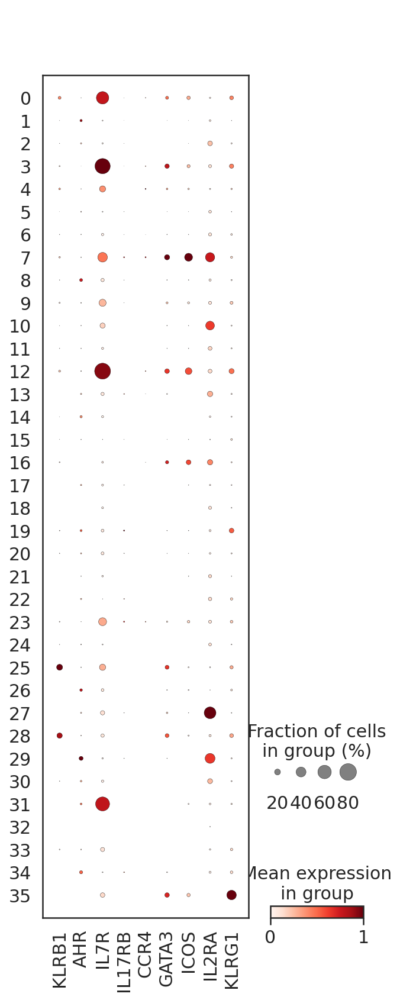

In [68]:
#dotplot
%matplotlib inline
marker_genes_filtered = G.identities['ILC2']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_pheno_var_k20']`


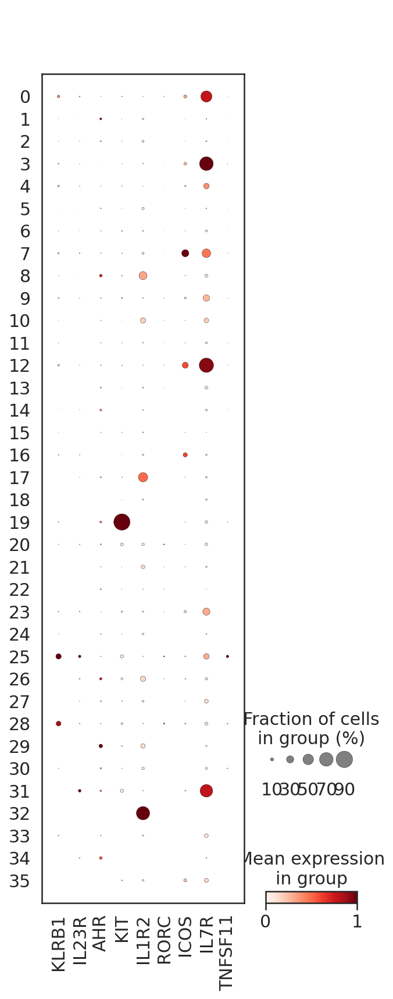

In [66]:
#dotplot
%matplotlib inline
marker_genes_filtered = G.identities['ILC3-NCRpos']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_pheno_var_k20']`


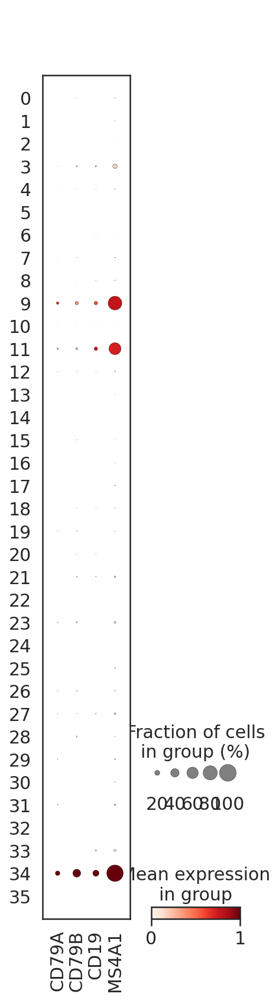

In [53]:
#dotplot
marker_genes_filtered = G.identities['B']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

In [65]:
G.identities.keys()

dict_keys(['TCM', 'TSCM', 'CD8-T_KLRG1pos-effector', 'TEM', 'FDC', 'Langerhans', 'B-memory-DN', 'Treg', 'B-memory-non-switched', 'CD56bright-NK', 'mono', 'B-pb-t1', 'NK-adaptive', 'mast', 'TRM', 'CD4-T', 'cDC2', 'p-DC', 'GC-B', 'B-memory-IgM-MZ', 'CD8-T', 'NK', 'T', 'ILC2', 'mo-DC', 'capillary', 'endo-systemic-venous', 'cDC3', 'B', 'gran', 'CD56dim-NK', 'cDC1', 'B-pb-t2', 'Lti', 'plasma', 'B-pb-mature', 'gdT', 'plasma-blast', 'CD8-T-progenitor-exhausted', 'Mac', 'B-memory-switched', 'ILC1', 'ILC3-NCRpos', 'CD8-T_KLRG1neg-effector', 'lung-endo-venous', 'ILC3-NCRneg', 'B-memory', 'endo-aerocyte', 'T-naive', 'B-naive'])

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_pheno_var_k20']`


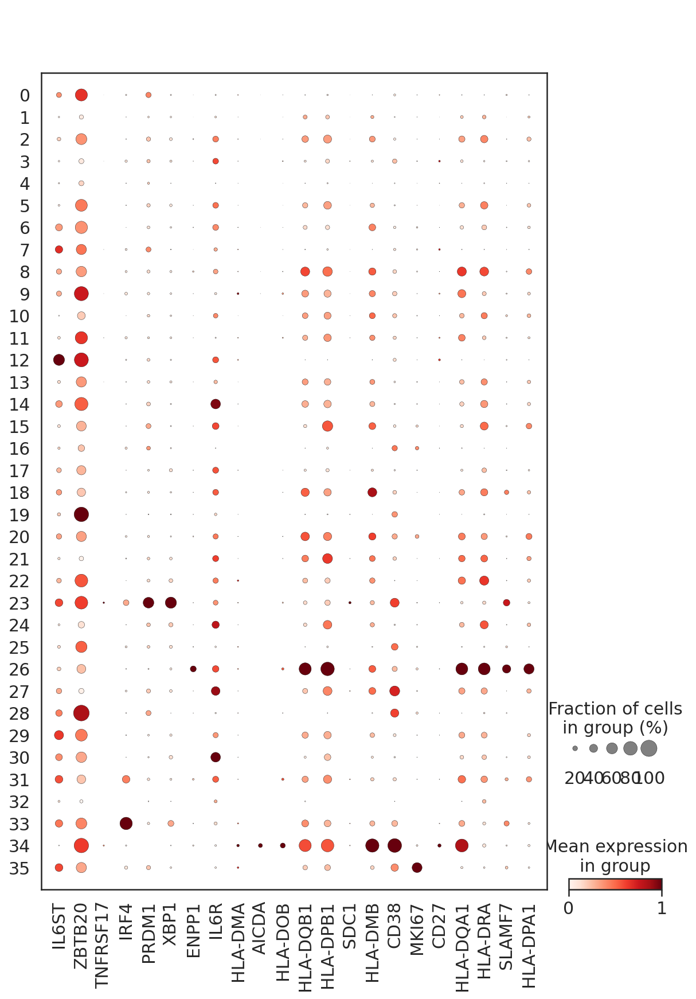

In [54]:
#dotplot
marker_genes_filtered = G.identities['plasma']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_pheno_var_k20']`


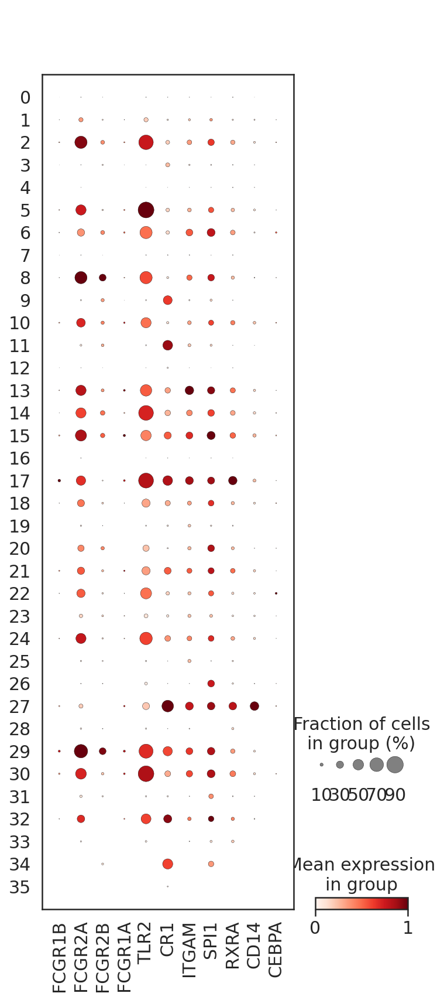

In [69]:
#dotplot
marker_genes_filtered = G.identities['mono']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_pheno_var_k20']`


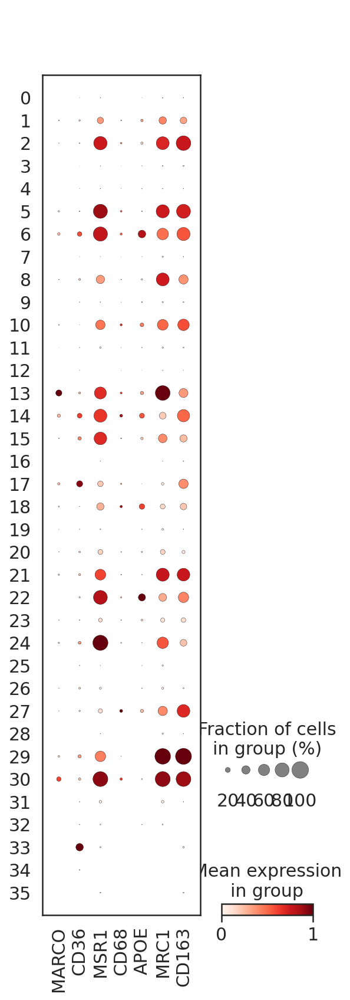

In [55]:
#dotplot
marker_genes_filtered = G.identities['Mac']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_pheno_var_k20']`


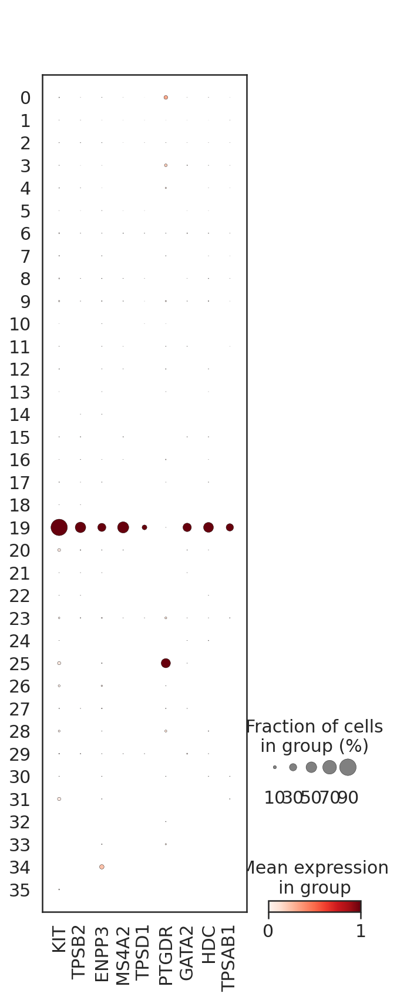

In [56]:
#dotplot
marker_genes_filtered = G.identities['mast']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_pheno_var_k20']`


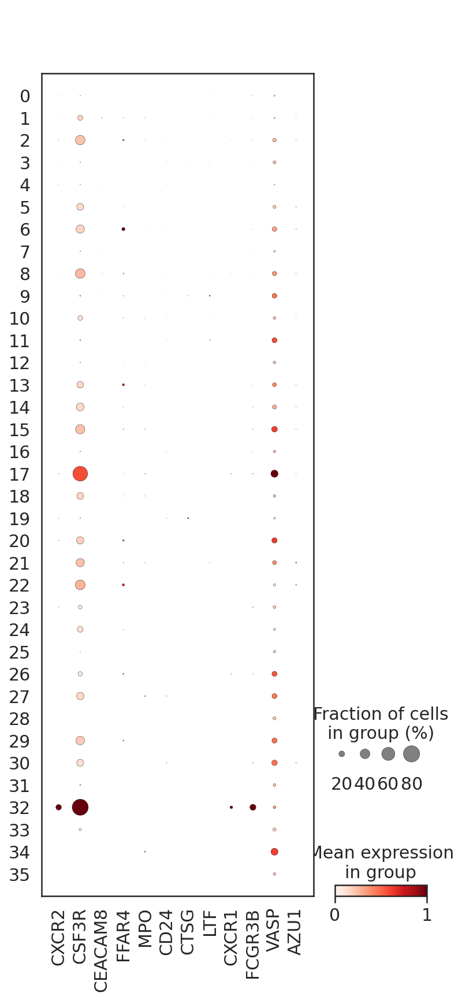

In [57]:
#dotplot
marker_genes_filtered = G.identities['gran']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_pheno_var_k20']`


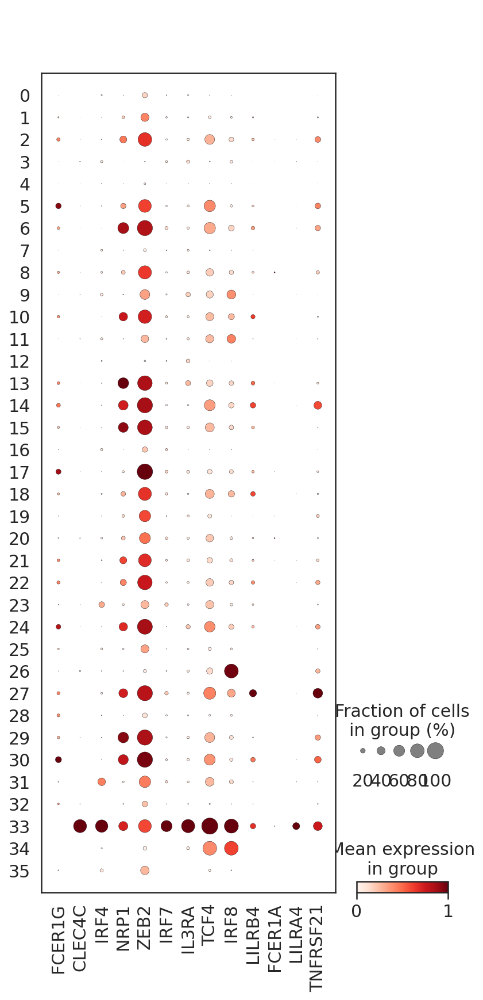

In [59]:
#dotplot
marker_genes_filtered = G.identities['p-DC']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_pheno_var_k20']`


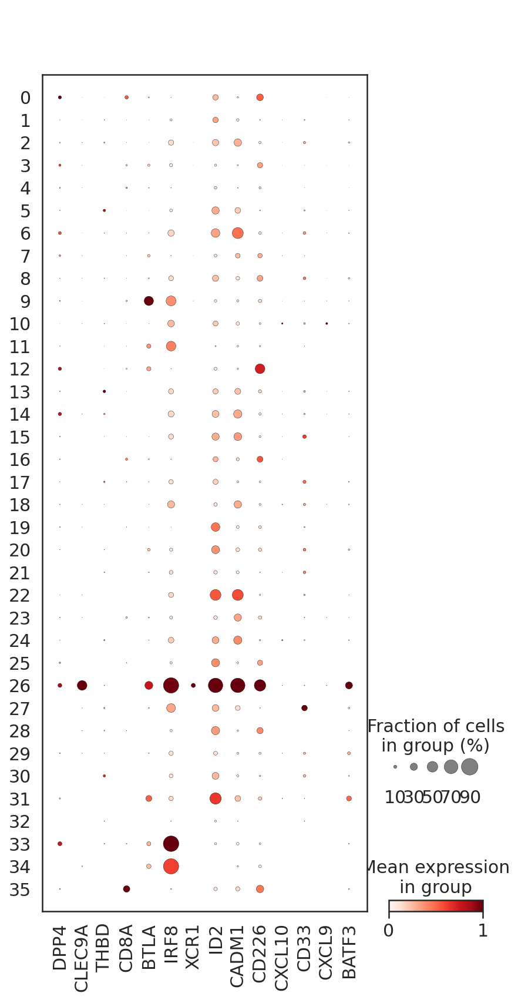

In [60]:
#dotplot
marker_genes_filtered = G.identities['cDC1']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_pheno_var_k20']`


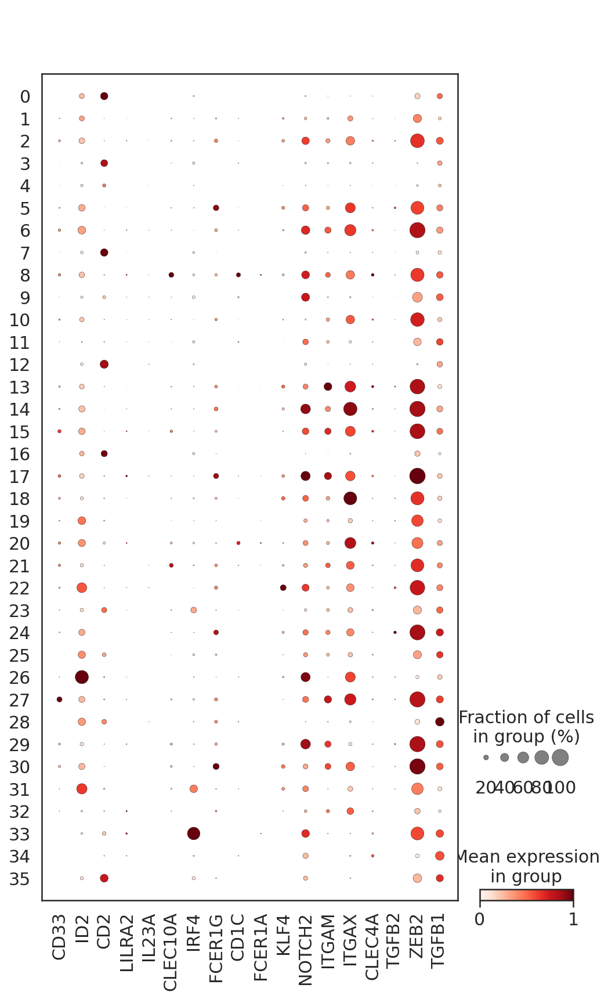

In [61]:
#dotplot
marker_genes_filtered = G.identities['cDC2']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_pheno_var_k20']`


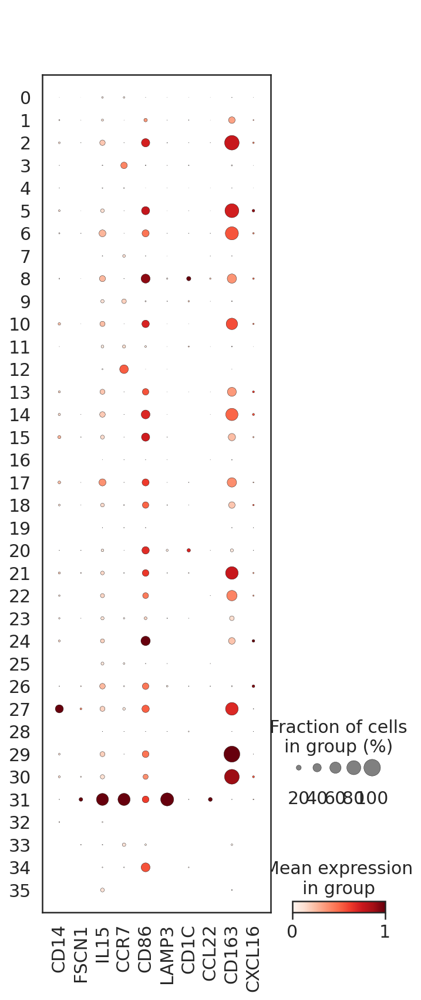

In [62]:
#dotplot
marker_genes_filtered = G.identities['cDC3']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_pheno_var_k20']`


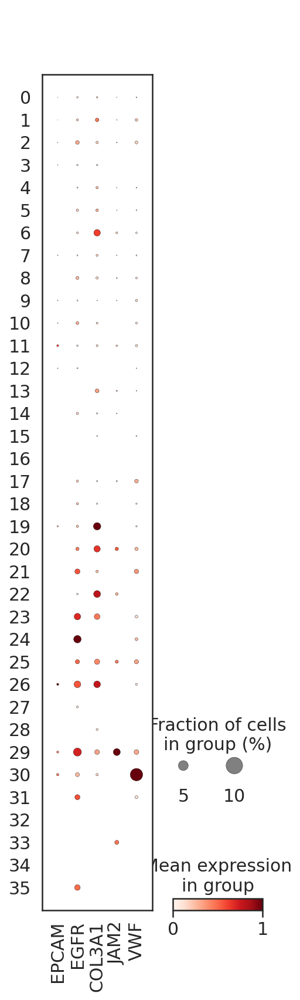

In [74]:
#dotplot
marker_genes_filtered = ['EPCAM','EGFR','COL3A1','JAM2','VWF']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

AnnData object with n_obs × n_vars = 20108 × 16286
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF', 'apCAF

ranking genes


/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/s

    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:38)


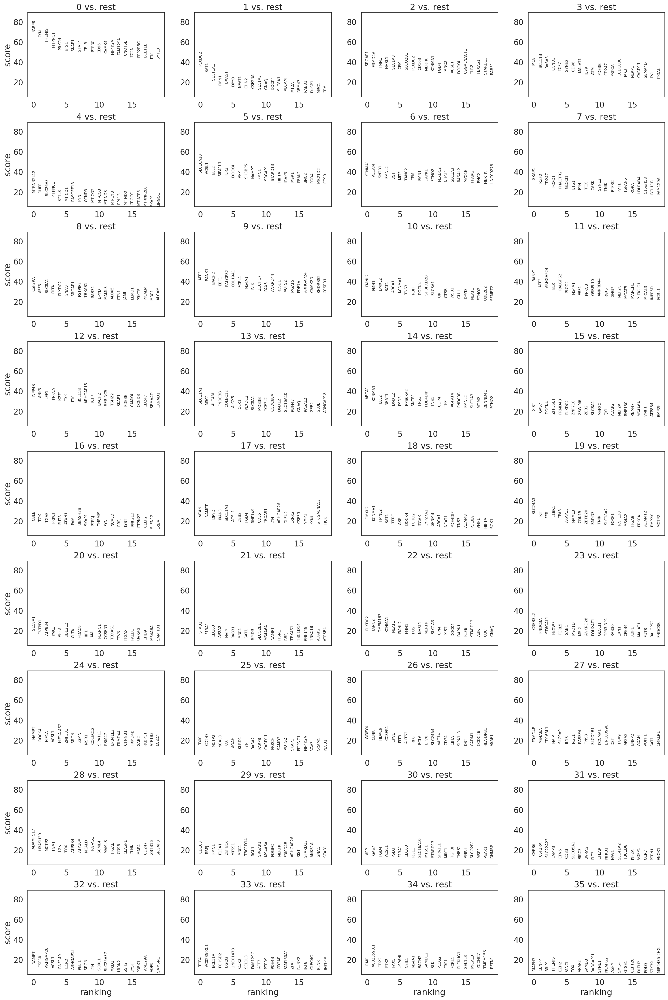

In [73]:
sc.tl.rank_genes_groups(adata, pheno_heat, method='wilcoxon')
sc.pl.rank_genes_groups(adata)

# annotate

In [11]:
from hierarchy import *

In [14]:
#adata paths

pheno_heat = 'pheno_var_k20'  
adata_path =  DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_immune_2500hv.h5ad'
adata_save_path = DATA_DIR +'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_immune_2500hv_annotated_{}.h5ad'

In [17]:
adata = sc.read(adata_path)

In [18]:
adata

AnnData object with n_obs × n_vars = 20108 × 16286
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF', 'apCAF

In [19]:
annotation_dict = {0:'TNK',
1:'M',
2:'M',
3:'TNK',
4:'TNK',
5:'M',
6:'M',
7:'TNK',
8:'M',
9:'BP',
10:'M',
11:'BP',
12:'TNK',
13:'M',
14:'M',
15:'M',
16:'TNK',
17:'M',
18:'M',
19:'M',
20:'M',
21:'M',
22:'M',
23:'TNK',
24:'M',
25:'TNK',
26:'M',
27:'M',
28:'TNK',
29:'M',
30:'M',
31:'M',
32:'M',
33:'M',
34:'BP',
35:'TNK'          
                }

In [20]:
adata.obs['annotation_level_0'] = adata.obs[pheno_heat].map(annotation_dict)
set(adata.obs['annotation_level_0'])

{'BP', 'M', 'TNK'}

In [21]:
save_path=adata_save_path.format('leuko')
adata.write(save_path)
print('saved to:',save_path)

saved to: /data/peer/wallet/Jupyter/2023_Particle_SASP/data/TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_immune_2500hv_annotated_leuko.h5ad


In [22]:
adata_subset = adata[adata.obs['annotation_level_0']=='TNK']
adata_subset

View of AnnData object with n_obs × n_vars = 7714 × 16286
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF',

In [23]:
save_path=adata_save_path.format('TNK')
adata_subset.write(save_path)
print('saved to:',save_path)

saved to: /data/peer/wallet/Jupyter/2023_Particle_SASP/data/TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_immune_2500hv_annotated_TNK.h5ad


In [24]:
adata_subset = adata[adata.obs['annotation_level_0']=='BP']
adata_subset

View of AnnData object with n_obs × n_vars = 1462 × 16286
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF',

In [25]:
save_path=adata_save_path.format('BP')
adata_subset.write(save_path)
print('saved to:',save_path)

saved to: /data/peer/wallet/Jupyter/2023_Particle_SASP/data/TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_immune_2500hv_annotated_BP.h5ad


In [26]:
adata_subset = adata[adata.obs['annotation_level_0']=='M']
adata_subset

View of AnnData object with n_obs × n_vars = 10932 × 16286
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF'

In [27]:
save_path=adata_save_path.format('M')
adata_subset.write(save_path)
print('saved to:',save_path)

saved to: /data/peer/wallet/Jupyter/2023_Particle_SASP/data/TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_immune_2500hv_annotated_M.h5ad
